In [27]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from PIL import Image
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import numpy as np
from collections import Counter
import re
from os import path
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300

In [28]:
# load dataset
df = pd.read_csv("Categorisation Dataset.csv")

In [33]:
# clean dataset
# remove data that has >280 characters and <15 characters
df = df[df["content"].str.len() <=280]
df = df[df["content"].str.len() >15]

# remove special characters
from nltk.corpus import stopwords as nltkstopwords
stops = set(nltkstopwords.words("english"))
def cleantext(string):
    text = string.lower().split()
    text = " ".join(text)
    text = re.sub(r"http(\S)+",' ',text)    
    text = re.sub(r"www(\S)+",' ',text)
    text = re.sub(r"&",' and ',text)  
    tx = text.replace('&amp',' ')
    text = re.sub(r"[^0-9a-zA-Z]+",' ',text)
    text = text.split()
    text = [w for w in text if not w in stops]
    text = " ".join(text)
    return text

df["content"] = df["content"].apply(cleantext)

shuffledDf = df.sample(frac=1).reset_index(drop=True)

shuffledDf

,Unnamed: 0,content,label
0,2863,michigan house passes bill voluntarily begin p...,1
1,801,spread covid 19 someone showing symptoms appea...,0
2,1796,trump mcconnell blocking stimulus checks ameri...,0
3,2478,rep devin nunes r calif said defending trump i...,1
4,2759,wisconsin gop refused make easier vote mail ap...,1
...,...,...,...
2827,2027,piles bricks staged cities around country indi...,1
2828,2147,look california look people color general afri...,1
2829,149,trey gowdy said im saying covid 19 isnt real p...,0
2830,2219,former u vice president joe biden 2020 preside...,1


In [19]:
df.to_csv("Categorisation Combined and Cleaned Dataset.csv", index=False)

In [20]:
# sample df for balanced dataset
normaldf = df[df["label"]==1]
coviddf = df[df["label"]==0]

normalColCount = len(normaldf)
covidColCount = len(coviddf)

sampleNumber = min(normalColCount, covidColCount)

normaldf = normaldf.sample(n=sampleNumber,random_state=1)
coviddf = coviddf.sample(n=sampleNumber,random_state=1)
print("normal count: ", normaldf.shape[0])
print("covid count: ",coviddf.shape[0])


normal count:  1109
covid count:  1109


In [21]:
df.to_csv("Sampled Categorisation Combined, Cleaned Dataset.csv", index=False)

Number of covid data 1734
Number of normal data 1098


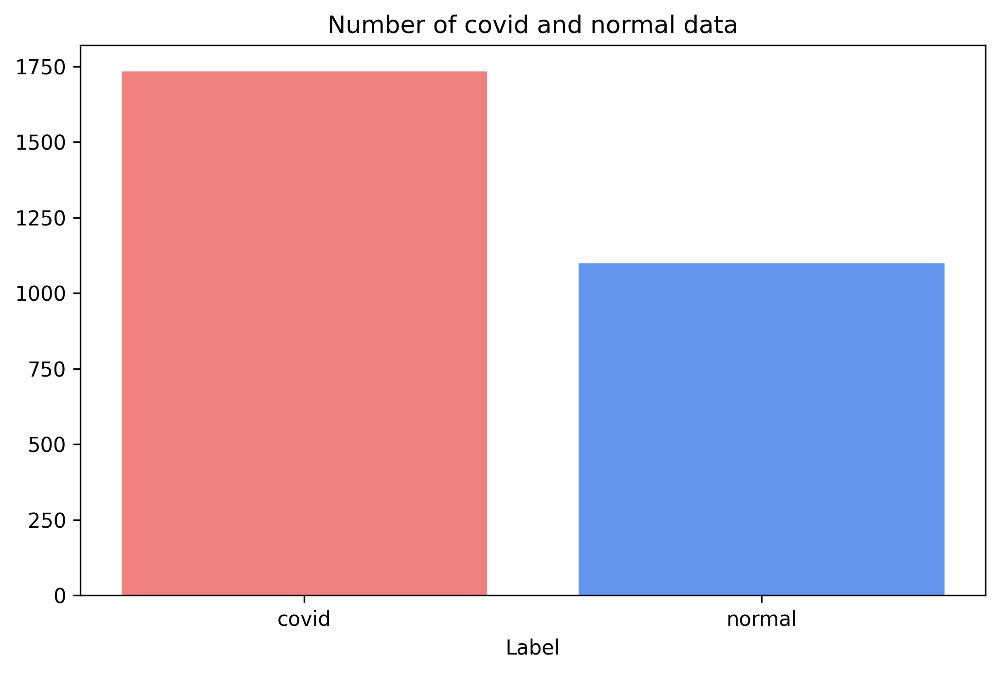

<function matplotlib.pyplot.show(close=None, block=None)>

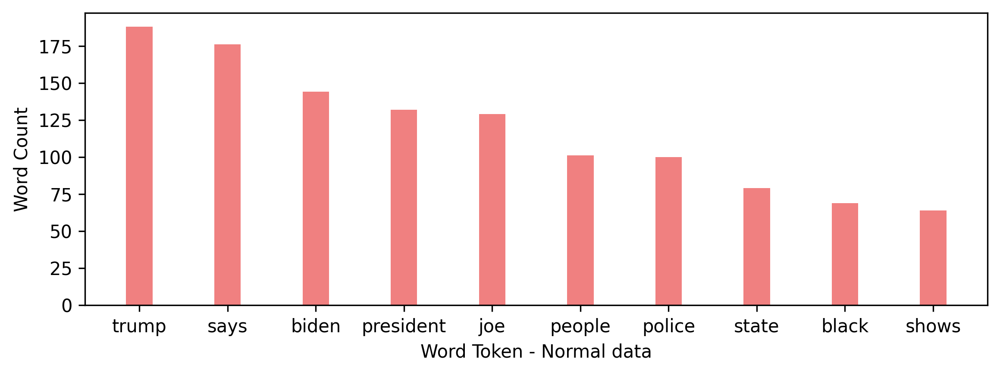

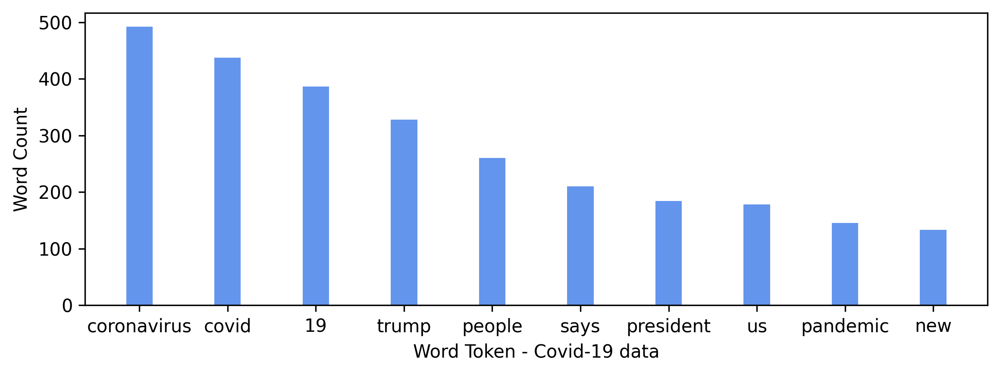

In [35]:
# Analyse Data
allText = df['content']
allTextCombined = ' '.join(allText)

fakeText = df[df.label == 0]
print("Number of covid data", fakeText.shape[0])
fakeTextCombined = ' '.join(fakeText["content"])

realText = df[df.label == 1]
print("Number of normal data", realText.shape[0])
realTextCombined = ' '.join(realText["content"])

allTokensWords = [w for w in str(allTextCombined).split() if len(w)>1 and w not in stops]
allWordCount = (Counter(allTokensWords).most_common(10))

fakeTokensWords = [w for w in str(fakeTextCombined).split() if len(w)>1 and w not in stops]
fakeWordCount = (Counter(fakeTokensWords).most_common(10))

realTokensWords = [w for w in str(realTextCombined).split() if len(w)>1 and w not in stops]
realWordCount = (Counter(realTokensWords).most_common(10))

plt.figure(figsize=(8,5))
plt.title("Number of covid and normal data")
plt.xlabel("Label")
plt.bar(["covid"],[fakeText.shape[0]],color="lightcoral")
plt.bar(["normal"],[realText.shape[0]],color="cornflowerblue")
plt.show()

ypos = np.arange(10)
plt.figure(figsize=(9,3))
plt.xticks(ypos, [i[0] for i in realWordCount])
plt.bar(ypos, [i[1] for i in realWordCount], width=0.3, color="lightcoral")
plt.xlabel("Word Token - Normal data")
plt.ylabel("Word Count")
plt.show

plt.figure(figsize=(9,3))
plt.xticks(ypos, [i[0] for i in fakeWordCount])
plt.bar(ypos, [i[1] for i in fakeWordCount], width=0.3, color="cornflowerblue")
plt.xlabel("Word Token - Covid-19 data")
plt.ylabel("Word Count")
plt.show




In [ ]:
# extra stops for word cloud
stops = stops.union({'pic','co','com','covid19','19','u','twitter'})

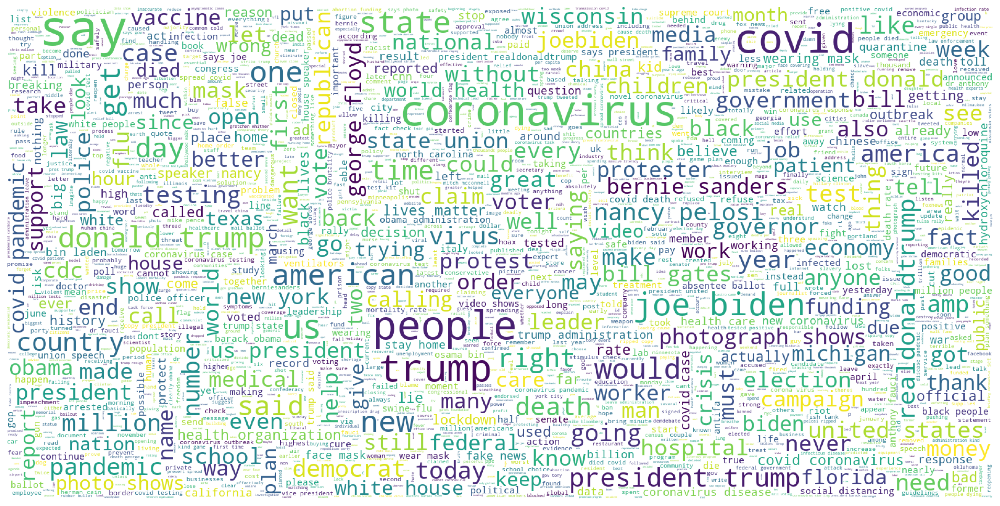

In [9]:
# wordcloud generation
wordcloud1 = WordCloud(background_color="white", max_words = 2000 , width = 1600 , height = 800,
               stopwords=stops, max_font_size=80, random_state=42).generate(str(allTextCombined))
plt.figure(figsize=(20,20))
plt.imshow(wordcloud1)
plt.axis("off")
plt.show()

(-0.5, 1599.5, 799.5, -0.5)

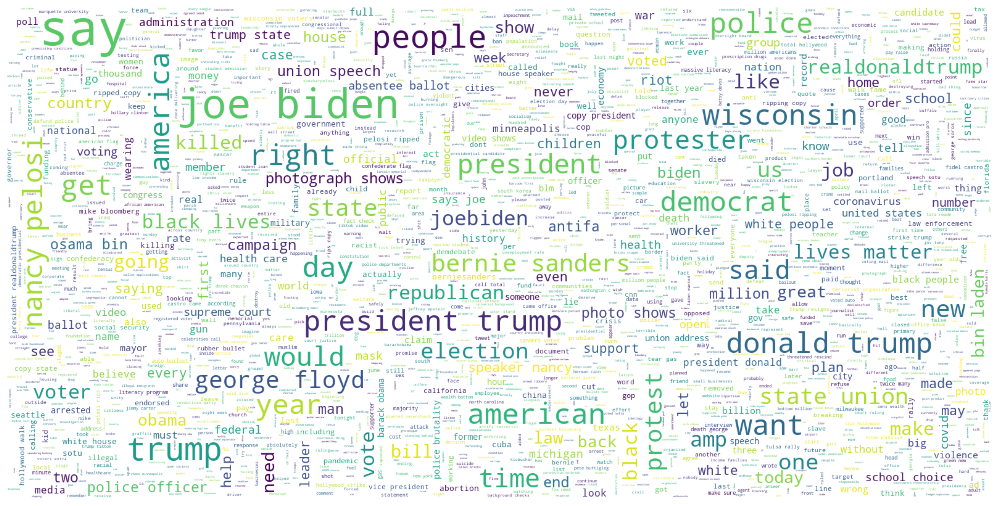

In [14]:
# normal news
corpus_str = str(realTextCombined)

wc = WordCloud(background_color="white", max_words = 2000 , width = 1600 , height = 800,
               stopwords=stops, max_font_size=80, random_state=42)

# generate word cloud
wc.generate(corpus_str)

# create coloring from image
#image_colors = ImageColorGenerator(coloring)
plt.figure(figsize = (20,20))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")


(-0.5, 1599.5, 799.5, -0.5)

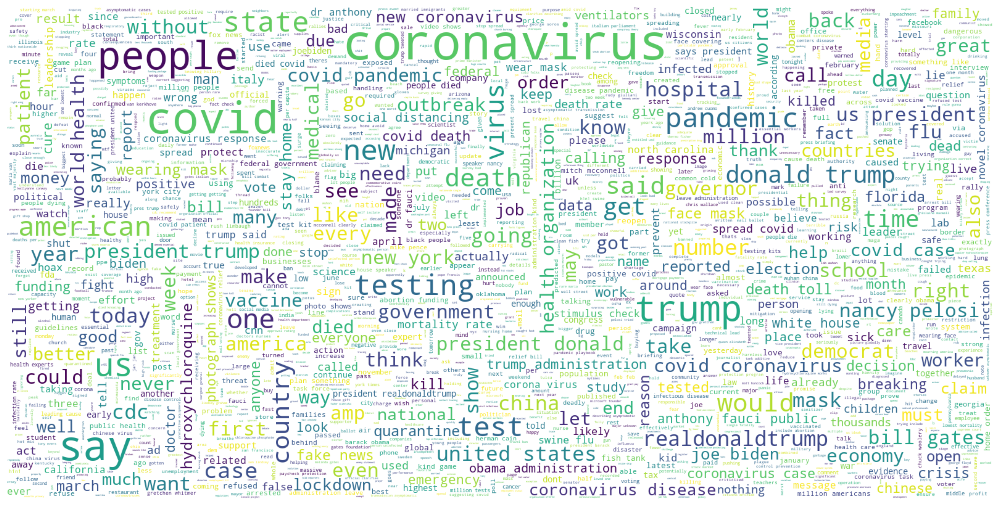

In [15]:
# fake news
corpus_str = str(fakeTextCombined)

wc = WordCloud(background_color="white", max_words = 2000 , width = 1600 , height = 800,
               stopwords=stops, max_font_size=80, random_state=42)

# generate word cloud
wc.generate(corpus_str)

plt.figure(figsize = (20,20))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
